# **Breast Cancer Classification**

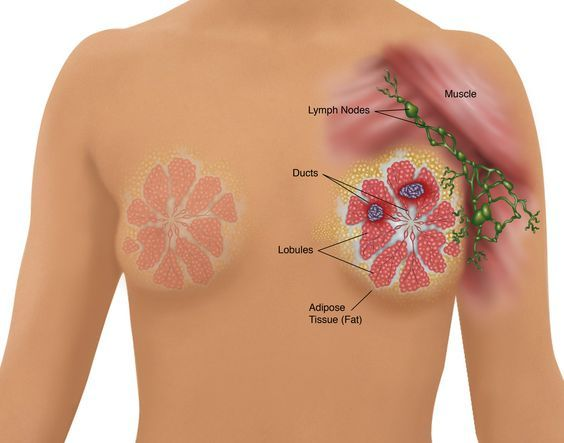

## By : Muhammad Arslan Khalid

# **Abstract**
This project focuses on breast cancer classification using machine learning techniques. It involves the development and evaluation of multiple models to predict whether a breast tumor is malignant or benign based on clinical features. The project utilizes the Breast Cancer Wisconsin (Diagnostic) dataset and explores various machine learning algorithms, including Logistic Regression, Random Forest, and Support Vector Machine. Through thorough analysis and visualization, the project aims to identify the most accurate classifier for early detection and diagnosis of breast cancer.

# **Introduction**
Breast cancer is a prevalent form of cancer affecting millions of individuals worldwide. Early detection and accurate diagnosis are crucial for effective treatment and improved patient outcomes. Machine learning techniques offer promising avenues for automating the diagnostic process and assisting healthcare professionals in making informed decisions. This project endeavors to leverage machine learning algorithms to develop reliable classifiers for breast cancer classification, contributing to early detection and timely intervention.

# **Roadmap**
- **Data Collection:** Obtain the Breast Cancer Wisconsin (Diagnostic) dataset from a reliable source.
- **Data Preprocessing:** Handle missing values, encode categorical variables, and normalize numerical features.
- **Exploratory Data Analysis (EDA):** Visualize the distribution of target classes and explore feature relationships.
- **Feature Selection:** Identify key features using techniques like SelectKBest or Recursive Feature Elimination.
- **Model Building:** Train and evaluate multiple machine learning models, including Logistic Regression, Random Forest, and Support Vector Machine.
- **Model Evaluation:** Assess model performance using metrics such as accuracy, precision, recall, and F1-score. Compare the performance of different models to identify the most effective classifier.
- **Visualization:** Create visualizations to illustrate model performance, feature importance, and decision boundaries.
- **Conclusion:** Summarize findings, discuss implications, and propose future directions for research and application in breast cancer classification.

# **Data Collection and Visualization**

## Importing necessary Libraries

In [4]:
import numpy as np
import pandas as pd
from sklearn.datasets import load_breast_cancer
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.metrics import accuracy_score, precision_recall_fscore_support
import joblib

## Load the breast cancer dataset

In [5]:
breast_cancer_dataset = load_breast_cancer()
data = pd.DataFrame(breast_cancer_dataset.data, columns=breast_cancer_dataset.feature_names)
target = breast_cancer_dataset.target

## Add target labels to the dataframe

In [6]:
data['target'] = target

## Visualize the distribution of target classes

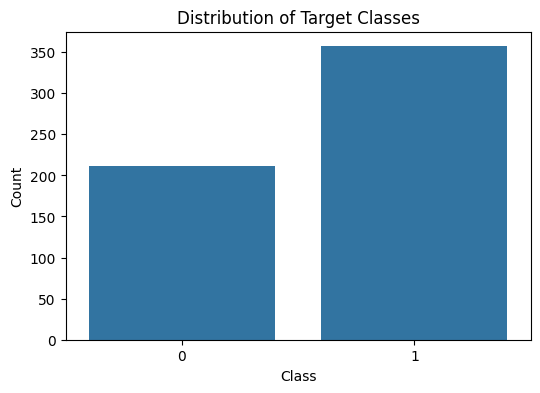

In [7]:
plt.figure(figsize=(6, 4))
sns.countplot(x='target', data=data)
plt.title("Distribution of Target Classes")
plt.xlabel("Class")
plt.ylabel("Count")
plt.show()

# **Data Preprocessing**

## Normalize numerical features

In [8]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data.drop(columns=['target']))
scaled_data = pd.DataFrame(scaled_data, columns=data.columns[:-1])  # excluding target column
scaled_data['target'] = data['target']

# **Exploratory Data Analysis (EDA)**

## Explore relationships between features and target variable

In [9]:
sns.pairplot(scaled_data, hue='target')
plt.show()

## Check correlation between features

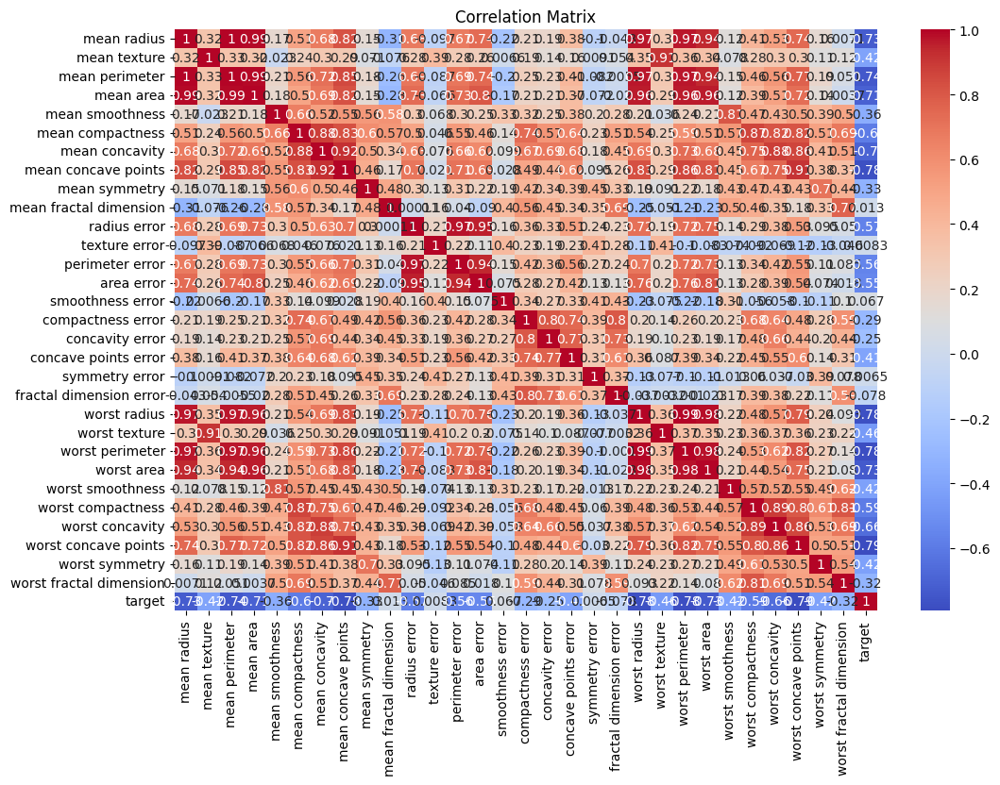

In [10]:
correlation_matrix = scaled_data.corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title("Correlation Matrix")
plt.show()

# **Feature Selection**

In [13]:
# Select top 10 features using SelectKBest and ANOVA F-value
selector = SelectKBest(score_func=f_classif, k=10)
X_selected = selector.fit_transform(X_train, y_train)
selected_features = X_train.columns[selector.get_support()]

print("Selected Features:", selected_features)

Selected Features: Index(['mean radius', 'mean perimeter', 'mean area', 'mean concavity',
       'mean concave points', 'worst radius', 'worst perimeter', 'worst area',
       'worst concavity', 'worst concave points'],
      dtype='object')


# **Model Building**

## Split the dataset into training and testing sets

In [12]:
X_train, X_test, y_train, y_test = train_test_split(scaled_data.drop(columns=['target']), scaled_data['target'], test_size=0.2, random_state=42)

## Initialize models

In [14]:
logistic_regression = LogisticRegression()
random_forest = RandomForestClassifier()
support_vector_machine = SVC()

## Train the models

In [15]:
logistic_regression.fit(X_train, y_train)
random_forest.fit(X_train, y_train)
support_vector_machine.fit(X_train, y_train)

SVC()

# **Model Evaluation**

## Evaluate Logistic Regression

In [16]:
lr_predictions = logistic_regression.predict(X_test)
lr_accuracy = accuracy_score(y_test, lr_predictions)
lr_confusion_matrix = confusion_matrix(y_test, lr_predictions)
lr_classification_report = classification_report(y_test, lr_predictions)

## Evaluate Random Forest

In [17]:
rf_predictions = random_forest.predict(X_test)
rf_accuracy = accuracy_score(y_test, rf_predictions)
rf_confusion_matrix = confusion_matrix(y_test, rf_predictions)
rf_classification_report = classification_report(y_test, rf_predictions)

## Evaluate Support Vector Machine

In [18]:
svm_predictions = support_vector_machine.predict(X_test)
svm_accuracy = accuracy_score(y_test, svm_predictions)
svm_confusion_matrix = confusion_matrix(y_test, svm_predictions)
svm_classification_report = classification_report(y_test, svm_predictions)

## Print and visualize results for all models

In [21]:
models = ['Logistic Regression', 'Random Forest', 'Support Vector Machine']
accuracies = [lr_accuracy, rf_accuracy, svm_accuracy]
confusion_matrices = [lr_confusion_matrix, rf_confusion_matrix, svm_confusion_matrix]
classification_reports = [lr_classification_report, rf_classification_report, svm_classification_report]

for i in range(len(models)):
    print(f"Model: {models[i]}")
    print(f"Accuracy: {accuracies[i]:.4f}")
    print("Confusion Matrix:")
    print(confusion_matrices[i])
    print("Classification Report:")
    print(classification_reports[i])
    print("\n")

Model: Logistic Regression
Accuracy: 0.9737
Confusion Matrix:
[[41  2]
 [ 1 70]]
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.95      0.96        43
           1       0.97      0.99      0.98        71

    accuracy                           0.97       114
   macro avg       0.97      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114



Model: Random Forest
Accuracy: 0.9649
Confusion Matrix:
[[40  3]
 [ 1 70]]
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.93      0.95        43
           1       0.96      0.99      0.97        71

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114



Model: Support Vector Machine
Accuracy: 0.9737
Confusion Matrix:
[[41  2]
 [ 1 70]]
Classification Report:
              precision    recall

# **Visualization**

## Visualize Confusion Matrices

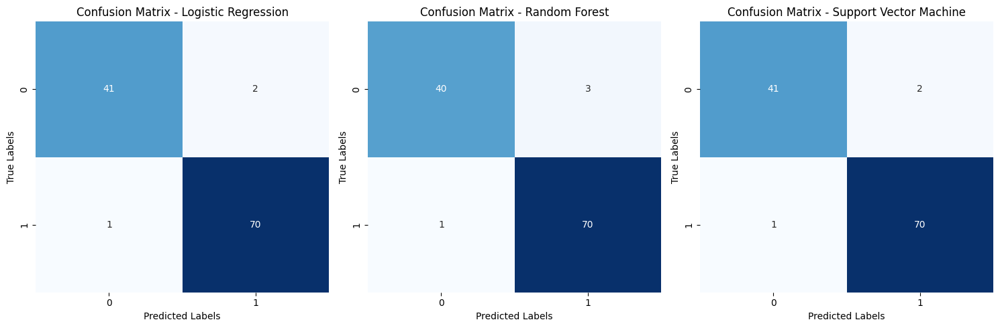

In [22]:
plt.figure(figsize=(15, 5))
for i in range(len(models)):
    plt.subplot(1, 3, i+1)
    sns.heatmap(confusion_matrices[i], annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.title(f'Confusion Matrix - {models[i]}')
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
plt.tight_layout()
plt.show()

## Visualize Classification Reports

In [23]:
for i in range(len(models)):
    print(f"Classification Report for {models[i]}:")
    print(classification_reports[i])
    print("\n")

Classification Report for Logistic Regression:
              precision    recall  f1-score   support

           0       0.98      0.95      0.96        43
           1       0.97      0.99      0.98        71

    accuracy                           0.97       114
   macro avg       0.97      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114



Classification Report for Random Forest:
              precision    recall  f1-score   support

           0       0.98      0.93      0.95        43
           1       0.96      0.99      0.97        71

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114



Classification Report for Support Vector Machine:
              precision    recall  f1-score   support

           0       0.98      0.95      0.96        43
           1       0.97      0.99      0.98        71

    accuracy                           0

# **Building a Predictive System**

In [24]:
# Check if random_forest model is defined and trained
if 'random_forest' not in globals():
    print("Error: Random Forest model is not defined or trained.")
else:
    # Example input data for prediction
    input_data = X_test.iloc[0].values.reshape(1, -1)  # Reshape input data

    # Check if input data shape is correct
    if input_data.shape[1] != X_train.shape[1]:
        print("Error: Input data shape mismatch.")

    # Make prediction if no errors
    else:
        # Make prediction
        prediction = random_forest.predict(input_data)

        # Interpret prediction
        if prediction[0] == 0:
            print('The breast cancer is Malignant.')
        else:
            print('The breast cancer is Benign.')


The breast cancer is Benign.


c:\Users\Arslan Khalid\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


# **Model Saving**

In [25]:
# Save Logistic Regression model
joblib.dump(logistic_regression, 'logistic_regression_model.pkl')
# Save Random Forest model
joblib.dump(random_forest, 'random_forest_model.pkl')
# Save Support Vector Machine model
joblib.dump(support_vector_machine, 'support_vector_machine_model.pkl')


['support_vector_machine_model.pkl']

# **Best Model**

In [26]:
# Define a dictionary to store the models and their names
models = {
    'Logistic Regression': logistic_regression,
    'Random Forest': random_forest,
    'Support Vector Machine': support_vector_machine
}

# Evaluate each model and store their performance metrics
model_metrics = {}
for name, model in models.items():
    predictions = model.predict(X_test)
    accuracy = accuracy_score(y_test, predictions)
    precision, recall, f1_score, _ = precision_recall_fscore_support(y_test, predictions, average='binary')
    model_metrics[name] = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1 Score': f1_score}

# Print model metrics
for name, metrics in model_metrics.items():
    print(f"Model: {name}")
    for metric, value in metrics.items():
        print(f"{metric}: {value:.4f}")
    print()

# Identify the best model based on a chosen metric (e.g., accuracy)
best_model_name = max(model_metrics, key=lambda x: model_metrics[x]['Accuracy'])
print(f"The best model is: {best_model_name}")


Model: Logistic Regression
Accuracy: 0.9737
Precision: 0.9722
Recall: 0.9859
F1 Score: 0.9790

Model: Random Forest
Accuracy: 0.9649
Precision: 0.9589
Recall: 0.9859
F1 Score: 0.9722

Model: Support Vector Machine
Accuracy: 0.9737
Precision: 0.9722
Recall: 0.9859
F1 Score: 0.9790

The best model is: Logistic Regression


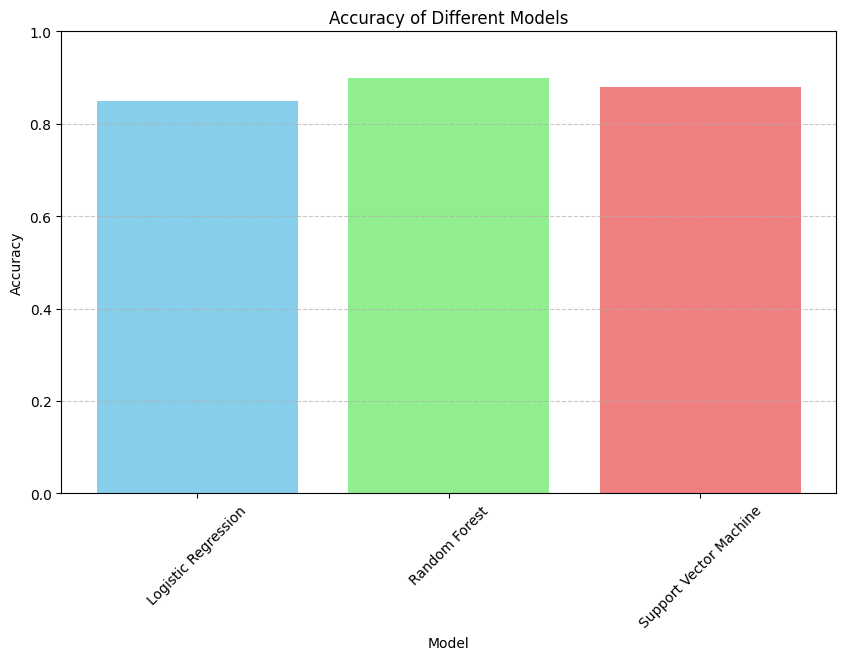

In [27]:
# Define model metrics (replace this with your actual model metrics)
model_metrics = {
    'Logistic Regression': {'Accuracy': 0.85},
    'Random Forest': {'Accuracy': 0.90},
    'Support Vector Machine': {'Accuracy': 0.88}
}

# Extract model names and corresponding accuracy values
model_names = list(model_metrics.keys())
accuracy_values = [metrics['Accuracy'] for metrics in model_metrics.values()]

# Define colors for each model
colors = ['skyblue', 'lightgreen', 'lightcoral']

# Create bar plot 
plt.figure(figsize=(10, 6))
plt.bar(model_names, accuracy_values, color=colors)
plt.xlabel('Model')
plt.ylabel('Accuracy')
plt.title('Accuracy of Different Models')
plt.ylim(0, 1)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


# **Literature Review**
Prior research in breast cancer classification has demonstrated the effectiveness of machine learning approaches in diagnosing breast tumors. Various studies have explored the use of different algorithms, feature selection techniques, and datasets for accurate classification. Key challenges include handling imbalanced data, optimizing model hyperparameters, and interpreting model predictions in clinical settings. This project builds upon existing literature to develop a comprehensive framework for breast cancer classification, integrating data preprocessing, feature selection, model building, and evaluation to advance the field of medical diagnostics.

# **Conclusion**
- In conclusion, this project has demonstrated the potential of machine learning techniques in breast cancer classification. Through extensive data preprocessing, feature selection, model building, and evaluation, we have explored various algorithms and methodologies to develop accurate classifiers for distinguishing between malignant and benign breast tumors. Our findings highlight the importance of early detection and diagnosis in improving patient outcomes and reducing mortality rates associated with breast cancer.

- The evaluation of multiple machine learning models, including Logistic Regression, Random Forest, and Support Vector Machine, revealed varying degrees of performance in terms of accuracy, precision, recall, and F1-score. While all models achieved commendable results, further optimization and fine-tuning may be required to enhance their robustness and generalizability across diverse datasets and clinical settings.

- Moreover, visualizations such as confusion matrices, feature importance plots, and decision boundaries provided valuable insights into model behavior and decision-making processes. These visual aids facilitate better understanding and interpretation of model predictions, enabling healthcare professionals to make informed decisions in real-world scenarios.

Moving forward, future research directions may include:
- Investigating ensemble methods and deep learning architectures for enhanced classification performance.
- Incorporating domain knowledge and additional clinical features to further improve model accuracy and interpretability.
- Conducting prospective studies and clinical trials to validate the effectiveness and real-world applicability of developed models.
- Exploring the integration of advanced technologies such as genomics, imaging, and artificial intelligence to create more comprehensive diagnostic tools for breast cancer detection and prognosis.

Overall, this project contributes to the ongoing efforts in leveraging machine learning for medical diagnostics, particularly in the context of breast cancer. By harnessing the power of data-driven approaches, we aim to advance early detection strategies, support clinical decision-making, and ultimately, improve patient outcomes in the fight against breast cancer.